<h1 align="center">Problem 2 - Practical HBM</h1>
<h2 align="center">One- and Two-Component Gaussian Mixture Hierarchcial Bayesian Modeling with PyJAGS</h2>
<h3 align="center">Simulating the eccentricity distribution of hot Jupiter exoplanets from the Kepler Mission</h3> 
<h4 align="center">LSSTC DSFP Session 4, September 21st, 2017</h4>
<h5 align="center">Author: Megan I. Shabram, PhD, 
NASA Postdoctoral Program Fellow,  mshabram@gmail.com</h5>


1. Use the PyJAGS model and analysis code below to explore a two-component truncated Gaussian mixture model
2. Using the simulated data code cells below, evaluate the one-component truncated Gaussian generative model simualted data with the two-component Gaussian mixture HBM. What do you notice about the posteriors for the mixture fractions? (Be sure to rename your output files).
3. Repeat this exersize but now evaluating simulated data from a one-component generative model with a two-component HBM. (Also be sure to rename your output files here as well). 
4. Notebook 3: Using the JAGS model code block for a break-point HBM, set up and evaluate the break-point HBM on the real Kepler eclipsing binary data set provided (some code is provided for analysis, but you may also want to copy code from previous notebooks, and be sure to adjust the number of traceplots and 2d marginals for latent variables.   



In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pyjags
import pickle

from __future__ import division, print_function
from pandas.tools.plotting import *
from matplotlib import rcParams
rcParams["savefig.dpi"] = 100
rcParams["font.size"] = 20
#plt.style.use('ggplot')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
#%qtconsole


Section 1. below provides code to run one-component h and k data through the one-component HBM, and section 2. provides code to run two-component h and k data through a two-component HBM. After executing and assessing these 2 sections, make a new notebook, or rearrange this notebook in order to run one-compinent data through a two-component HBM, and two-component data through the one-component HBM, (swap the data and HBM combo) to answer Question 2 above.  Pay attention to the mixture fractions when running one-component data through the two-component HBM.   

<h3 align="left"> 1. Generate simulated data sets: one- and two-component truncated Gaussian mixture generative models:</h3>


In [3]:
## function to draw from truncated normal, this function will be used for both the 
## one- and two-componenet cases in this workbook.  

def rnorm_bound( Ndata, mu, prec, lower_bound = 0.0, upper_bound = float('Inf')):
    x = np.zeros(Ndata)
    #print(x)
    for i in range(0, Ndata): 
            #print(i)
            while True:
                x[i] = np.random.normal(mu,prec,1)
                if( (x[i]>lower_bound) and (x[i]<upper_bound) ): 
                    break
    return x;

In [4]:
## Check the output to make sure the function is outputting as expected. 
#print(np.random.normal(0,0.0001,10))
print(rnorm_bound(10, 0.0, 0.001, lower_bound=-1,upper_bound=1))

[ -1.80719882e-04   3.91699486e-04   1.73292193e-04  -5.09164397e-04
   1.00014241e-03   1.39972357e-03   8.65809575e-04  -1.37250506e-03
   9.29018934e-05  -1.25781229e-03]


<p>Below we are now simulating the distribution of both "$\boldsymbol{e \cos \omega}$" and "$\boldsymbol{e \sin \omega}$", $h$ and $k$ respectively, for hot Jupiter exoplanets from  <i>Kepler</i>. </p> 

[-0.41393112  0.11627835  0.14173597 -0.23562997 -0.42923673  0.31493326
 -0.44727581  0.07867351  0.18142182  0.05491008 -0.23725838 -0.34968788
  0.63154433 -0.21773651 -0.26725093 -0.10486356  0.26706864 -0.3596925
  0.52535476  0.02782112  0.09455172  0.15646653 -0.45867488 -0.14759476
 -0.23519005] [-0.39282589  0.10398277  0.185119   -0.20702566 -0.43025947  0.2747293
 -0.46360995  0.11549319  0.10651453 -0.01975278 -0.22597231 -0.32721677
  0.66174235 -0.22432501 -0.28507912 -0.10197261  0.26370011 -0.31493765
  0.53479582 -0.00652395  0.03023311  0.20159958 -0.50495863 -0.13666951
 -0.22402531] [ 0.06423514 -0.07986823  0.03107364  0.31301882  0.07586652  0.26847098
  0.15326399  0.06043858 -0.20819372  0.58605335  0.37366381 -0.16299988
 -0.04839924  0.04344782 -0.25254797 -0.32124179  0.03613562  0.24262385
  0.43616172  0.7381449  -0.30428953  0.22602305 -0.06654293  0.0154422
  0.02315476] [ 0.07775903 -0.09135196 -0.03922595  0.33111341  0.20831491  0.27086349
  0.12367224

(array([ 4.,  3.,  4.,  2.,  3.,  4.,  3.,  0.,  1.,  1.]),
 array([-0.50495863, -0.38828853, -0.27161844, -0.15494834, -0.03827824,
         0.07839186,  0.19506196,  0.31173206,  0.42840216,  0.54507225,
         0.66174235]),
 <a list of 10 Patch objects>)

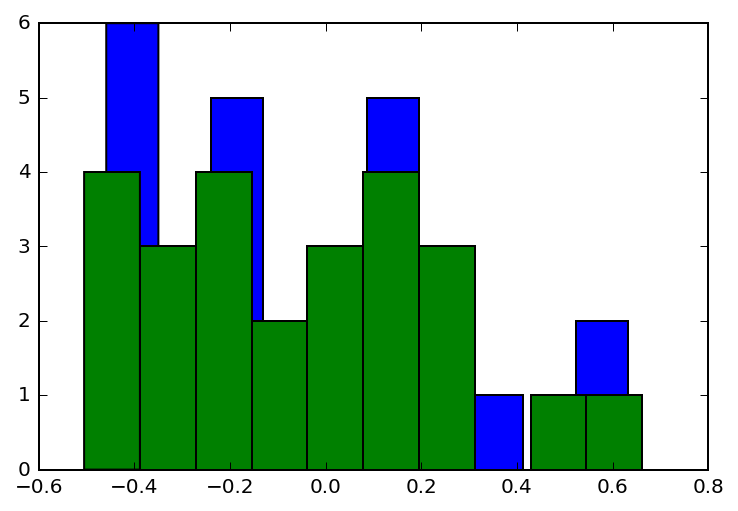

In [5]:
## One-component Gaussian Mixture Simulated Data for both projected eccentricity terms
## Below we designate the population values of our generative model. These are the 
## truths that we should recover if our hiararchical Bayesian model is properly specified 
## and diagnostics have indicated that the simulation has "not not converged". "You can't 
## prove convergence, at best you can fail to prove a failure to converge".

## In this simulated data set, their are 25 planetary systems (with one planet each)
Ndata = 25 
## Here we asign the dispersion of the simulated population to be 0.3, this is 
## the truth we wish to recover 
sigmae = 0.3 
## We approximate the uncertainty for each measurement as normally distributed about a 
## reported measurement point estimate.  
## For the eccentricity distribution for hot Jupiters, the physical models used to derive 
## these produce larger uncertainty in k by a factor of 2. 
sigmahobs = 0.04
sigmakobs = 0.08

h = np.repeat(0.,Ndata)
k = np.repeat(0.,Ndata)
hhat = np.repeat(0.,Ndata)
khat = np.repeat(0.,Ndata)
hhat_sigma  = np.repeat(sigmahobs,Ndata)
khat_sigma  = np.repeat(sigmakobs,Ndata)

#print(khat_sigma)


for i in range(0,Ndata):
    h[i] = rnorm_bound(1,0,sigmae,lower_bound=-1,upper_bound=1)
    lb = -np.sqrt(1-h[i]**2)
    ub = np.sqrt(1-h[i]**2)
    k[i] = rnorm_bound(1,0,sigmae,lower_bound=lb,upper_bound=ub) 
    hhat[i] = rnorm_bound(1,h[i],sigmahobs,lower_bound=-1,upper_bound=1)
    khat[i] = rnorm_bound(1,k[i],sigmakobs,lower_bound=lb,upper_bound=ub)

## Vizualize the true data values, and the simulated measurements:     
print(h, hhat, k, khat)
plt.hist(h)
plt.hist(hhat)

Below is the one-component Gaussian mixture model in JAGS copied from notebook 1, and gerneralized to also include k in addition to h:

In [6]:
## JAGS user manual: 
## http://www.uvm.edu/~bbeckage/Teaching/DataAnalysis/Manuals/manual.jags.pdf

## JAGS model code

## model code is the one-component truncated gaussian mixture HBM code from previous 
## notebook


code1 = '''

model {
        
    #Population parameters
    e_sigma ~ dunif(0.0, 1.0)
    e_phi <- 1/(e_sigma*e_sigma)
        
    for (n in 1:Ndata){
    
        #True planet properties
        h[n] ~ dnorm(0, e_phi) T(-1,1) #Can try multivariate truncated normal in future
        k[n] ~ dnorm(0, e_phi) T(-sqrt(1-h[n]*h[n]),sqrt(1-h[n]*h[n]))
            
        #Observed planet properties
        hhat[n] ~ dnorm(h[n], 1.0/(hhat_sigma[n]*hhat_sigma[n])) T(-1,1)
        khat[n] ~ dnorm(k[n], 1.0/(khat_sigma[n]*khat_sigma[n])) T(-sqrt(1-hhat[n]*hhat[n]),sqrt(1-hhat[n]*hhat[n]))
    }
        
}
'''

In [7]:
## Load additional JAGS module
pyjags.load_module('glm')
pyjags.load_module('dic')


## See blog post for origination of some of the adapted analysis tools used here and below:
## https://martynplummer.wordpress.com/2016/01/11/pyjags/

num_chains = 4
iterations = 10000


## data list include only variables in the model
model = pyjags.Model(code1, data=dict( Ndata=Ndata, hhat=hhat, khat=khat, 
                                     hhat_sigma=hhat_sigma, khat_sigma=khat_sigma), 
                     chains=num_chains, adapt=1000)

## Code to speed up compute time. This feature might not be 
## well tested in pyjags at this time. 
## threads=4, chains_per_thread=1 

## 500 warmup / burn-in iterations, not used for inference.
model.sample(500, vars=[])

## Run model for desired steps, monitoring hyperparameter variables, and latent variables
## for hierarchical Bayesian model.
## Returns a dictionary with numpy array for each monitored variable.
## Shapes of returned arrays are (... shape of variable ..., iterations, chains).
## samples = model.sample(#iterations per chain here, vars=['e_sigma', 'h', 'k'])
samples = model.sample(iterations, vars=['e_sigma', 'h', 'k'])

## Code to save, open and use pickled dictionary of samples:
## -- Pickle the data --
#with open('ecc_1_test.pkl', 'wb') as handle:
#   pickle.dump(samples, handle)
## -- Retrieve pickled data --
#with open('ecc_1_test.pkl', 'rb') as handle:
#   retrieved_results = pickle.load(handle)


adapting: iterations 4000 of 4000, elapsed 0:00:02, remaining 0:00:00
sampling: iterations 2000 of 2000, elapsed 0:00:01, remaining 0:00:00
sampling: iterations 14816 of 40000, elapsed 0:00:06, remaining 0:00:10
sampling: iterations 40000 of 40000, elapsed 0:00:15, remaining 0:00:00
sampling: iterations 40000 of 40000, elapsed 0:00:15, remaining 0:00:00


In [8]:
## Generalize code for both h and k below. 

#print(samples)
#print(samples.items())

## Print and check the shape of the resultant samples dictionary:
print(samples['e_sigma'].shape)
print(samples['e_sigma'].squeeze(0).shape)
print(samples['h'].shape)
print(samples['k'][0,:,:].shape)
print('-----')


## Update the samples dictionary so that it includes keys for the latent variables
## Also, we will use LaTeX formatting to help make legible plots ahead.  
samples_Nm1 = {}

## adjust the thin varible to only look at every 10th population element by setting it to 10
thin = 1
## Need to enter the number of hyperparameter variables here:
numHyperParams = 1
## Specify the dimension we want for our plot below, for legibility.  
dim = (Ndata/thin)*2 + numHyperParams
print(dim)

for i in np.arange(0,Ndata,thin):
    #hval = 'h'+str(i+1)
    #kval = 'k'+str(i+1)
    #print(hval)
    #print(kval)
    #samples_Nm1({hval: samples['h'][i,:,:]})
    samples_Nm1.update({'$h_{'+str(i+1)+'}$': samples['h'][i,:,:], '$k_{'+str(i+1)+'}$': samples['k'][i,:,:]})
#print(samples_2['h11'].shape)

## Add the hyperparameter marginal posterior back in:
samples_Nm1.update({'$e_{\sigma}$': samples['e_sigma'].squeeze(0)})

## Below, examine the updated and reformatted sample dictionary to include keys for 
## latent variables 
for j, i in samples_Nm1.items():
    print(j)
    print(i)
samples_Nm1['$h_{5}$'][0]

(1, 10000, 4)
(10000, 4)
(25, 10000, 4)
(10000, 4)
-----
51.0
$h_{2}$
[[ 0.10253433  0.1316362   0.12834745  0.11735116]
 [ 0.12571712  0.09899074  0.08417513  0.13720439]
 [ 0.08590829  0.06385894  0.08635107  0.11630583]
 ..., 
 [ 0.10566881  0.10799076  0.06841691  0.09455784]
 [ 0.11957904  0.05727128  0.07206843  0.13560663]
 [ 0.1911698   0.16288726  0.10558219  0.13052772]]
$k_{6}$
[[ 0.23303026  0.26924439  0.21380337  0.2906679 ]
 [ 0.18445061  0.37390697  0.10106424  0.32905733]
 [ 0.19003709  0.14877965  0.26174171  0.28849964]
 ..., 
 [ 0.36418163  0.11552718  0.1608084   0.3521669 ]
 [ 0.36735784  0.28963655  0.19474252  0.35273288]
 [ 0.36448591  0.18834827  0.25173262  0.19722346]]
$k_{17}$
[[ 0.1132385   0.0409769   0.06768613  0.059573  ]
 [ 0.08030623 -0.03360544  0.04774691  0.00832563]
 [ 0.06720722 -0.02875597  0.03532517 -0.04178938]
 ..., 
 [-0.03447416  0.02065731  0.06513859  0.05088001]
 [ 0.10912378  0.01995673  0.1407263   0.05323889]
 [ 0.16707742  0.080941

array([-0.42132457, -0.42506736, -0.41293575, -0.42349471])

<p>Below is code to look at <b>summary statistics</b> of <b>the marginal posterior distributions</b>  (the probabilistic parameter estimates) 
for the hyperparameter and the latent variables 
(each population constituent), in this case <i>h</i> and <i>k</i> (a.k.a projected eccentricity here), of the exoplanet systems we are simulating). </p> 

In [9]:
## equal tailed 95% credible intervals, and posterior distribution means:
def summary(samples, varname, p=95):
    values = samples[varname][0]
    ci = np.percentile(values, [100-p, p])
    print('{:<6} mean = {:>5.1f}, {}% credible interval [{:>4.1f} {:>4.1f}]'.format(
      varname, np.mean(values), p, *ci))

for varname in samples_Nm1:
    summary(samples_Nm1, varname)


$h_{2}$ mean =   0.1, 95% credible interval [ 0.1  0.1]
$k_{6}$ mean =   0.3, 95% credible interval [ 0.2  0.3]
$k_{17}$ mean =   0.1, 95% credible interval [ 0.0  0.1]
$h_{3}$ mean =   0.2, 95% credible interval [ 0.2  0.3]
$h_{14}$ mean =  -0.2, 95% credible interval [-0.3 -0.2]
$k_{16}$ mean =  -0.2, 95% credible interval [-0.3 -0.2]
$k_{14}$ mean =   0.1, 95% credible interval [ 0.1  0.2]
$h_{15}$ mean =  -0.3, 95% credible interval [-0.3 -0.2]
$h_{17}$ mean =   0.3, 95% credible interval [ 0.2  0.3]
$h_{5}$ mean =  -0.4, 95% credible interval [-0.4 -0.4]
$k_{24}$ mean =  -0.1, 95% credible interval [-0.2 -0.1]
$h_{18}$ mean =  -0.3, 95% credible interval [-0.3 -0.2]
$h_{19}$ mean =   0.5, 95% credible interval [ 0.5  0.6]
$k_{11}$ mean =   0.5, 95% credible interval [ 0.5  0.6]
$e_{\sigma}$ mean =   0.3, 95% credible interval [ 0.3  0.3]
$k_{22}$ mean =   0.4, 95% credible interval [ 0.3  0.5]
$k_{7}$ mean =   0.1, 95% credible interval [ 0.0  0.2]
$k_{9}$ mean =  -0.3, 95% credib

Variable
$e_{\sigma}$    0.309311
$h_{10}$       -0.019250
$h_{11}$       -0.222060
$h_{12}$       -0.321545
$h_{13}$        0.650822
$h_{14}$       -0.220601
$h_{15}$       -0.280473
$h_{16}$       -0.100235
$h_{17}$        0.259326
$h_{18}$       -0.309588
$h_{19}$        0.525893
$h_{1}$        -0.385865
$h_{20}$       -0.006464
$h_{21}$        0.029371
$h_{22}$        0.198489
$h_{23}$       -0.496816
$h_{24}$       -0.134250
$h_{25}$       -0.220330
$h_{2}$         0.102328
$h_{3}$         0.182095
$h_{4}$        -0.203770
$h_{5}$        -0.423044
$h_{6}$         0.270204
$h_{7}$        -0.456033
$h_{8}$         0.113666
$h_{9}$         0.104413
$k_{10}$        0.551398
$k_{11}$        0.499614
$k_{12}$       -0.245080
$k_{13}$       -0.149712
$k_{14}$        0.115249
$k_{15}$       -0.277455
$k_{16}$       -0.264313
$k_{17}$        0.074255
$k_{18}$        0.277206
$k_{19}$        0.392612
$k_{1}$         0.073636
$k_{20}$        0.692894
$k_{21}$       -0.137406
$k_{22}$        

//anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


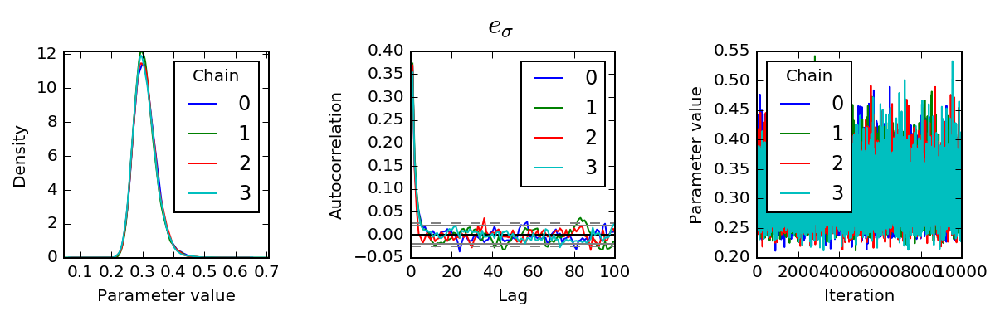

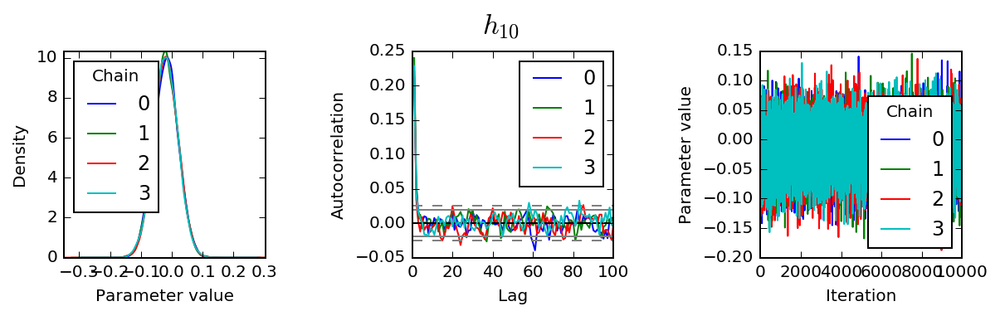

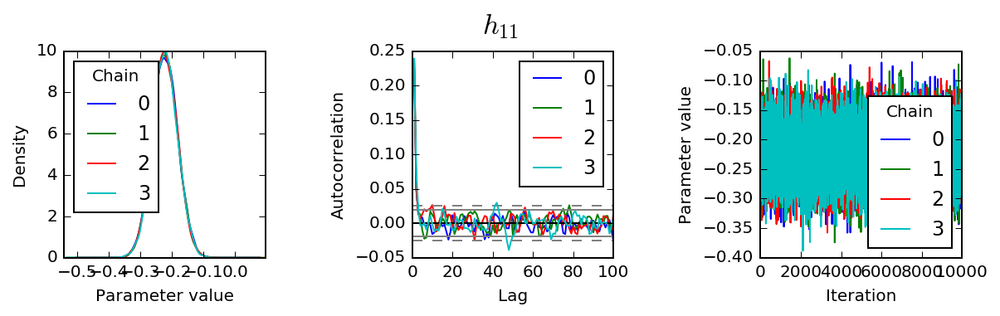

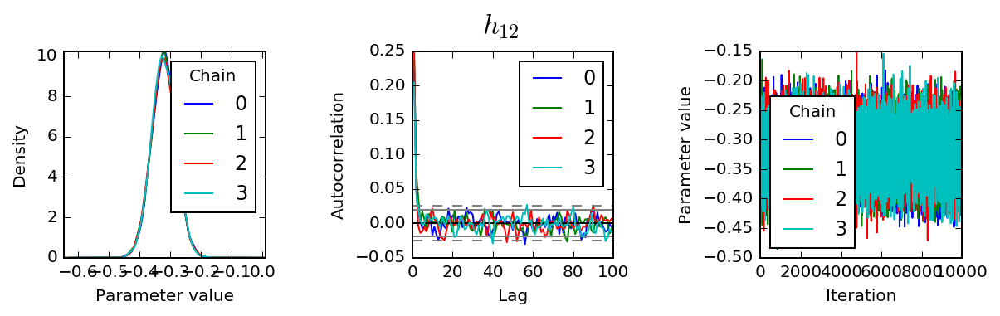

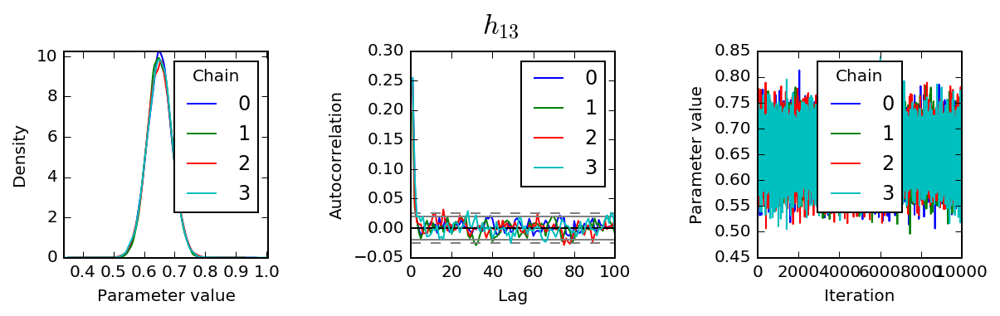

...

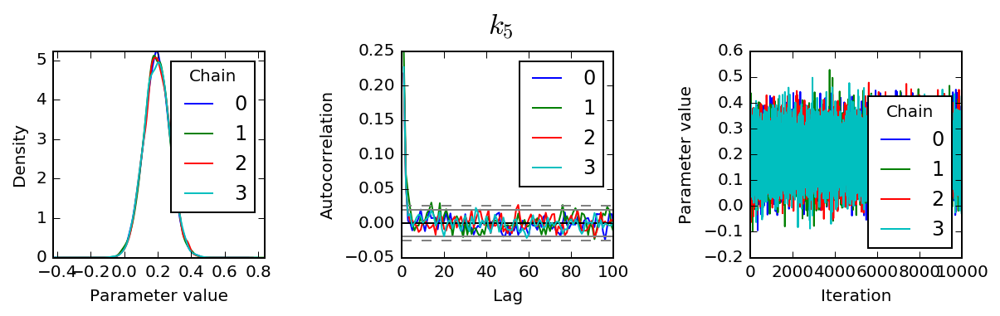

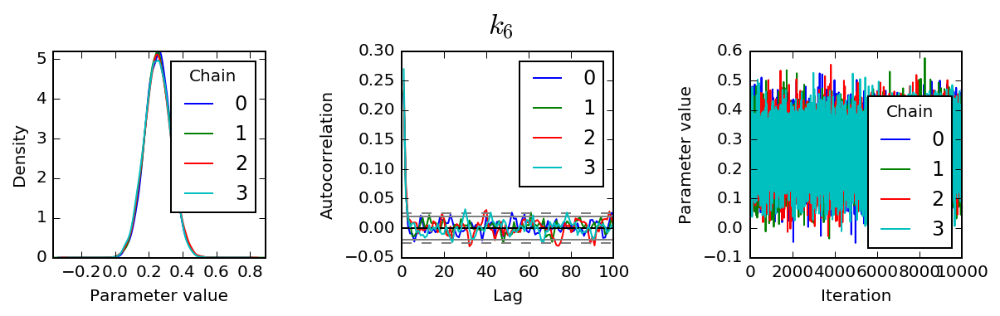

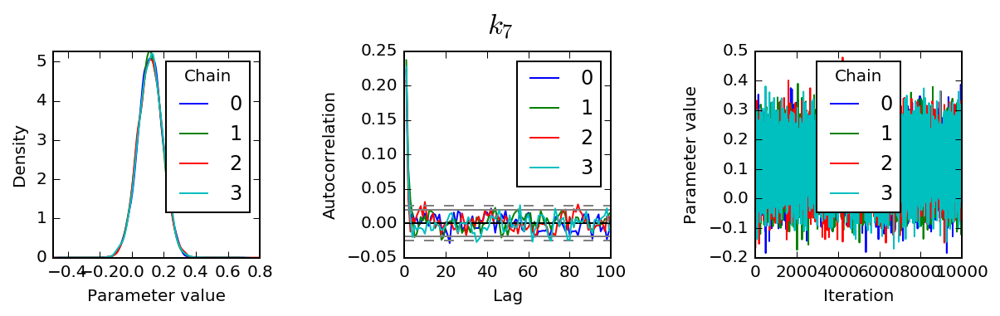

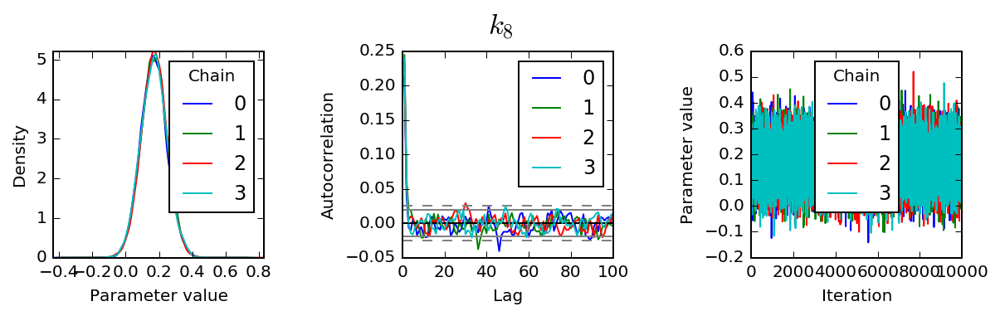

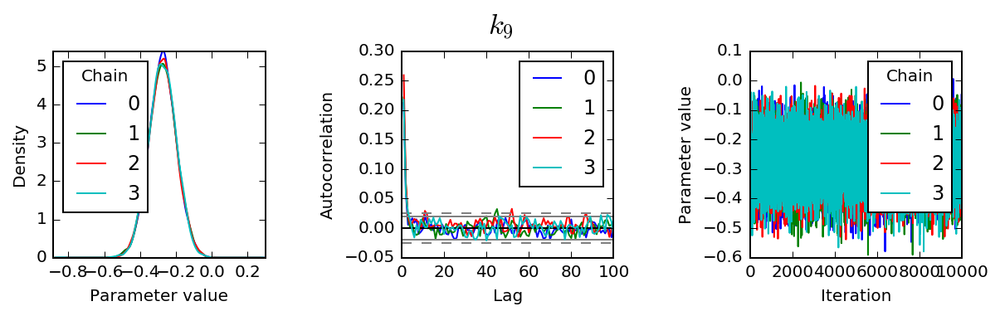

In [10]:
## Use pandas three dimensional Panel to represent the trace:

trace = pd.Panel({k: v for k, v in samples_Nm1.items()})
trace.axes[0].name = 'Variable'
trace.axes[1].name = 'Iteration'
trace.axes[2].name = 'Chain'
 
## Point estimates:
print(trace.to_frame().mean())
 
## Bayesian equal-tailed 95% credible intervals:
print(trace.to_frame().quantile([0.05, 0.95]))
  ## ^ entering the values here could be a good question part
    
def plot(trace, var):
    fig, axes = plt.subplots(1, 3, figsize=(9, 3))
    fig.suptitle(var, y=0.95, fontsize='xx-large')
 
    ## Marginal posterior density estimate:
    trace[var].plot.density(ax=axes[0])
    axes[0].set_xlabel('Parameter value')
    axes[0].locator_params(tight=True)
 
    ## Autocorrelation for each chain:
    axes[1].set_xlim(0, 100)
    for chain in trace[var].columns:
        autocorrelation_plot(trace[var,:,chain], axes[1], label=chain)
 
    ## Trace plot:
    axes[2].set_ylabel('Parameter value')
    trace[var].plot(ax=axes[2])
 
    ## Save figure
    filename = var.replace("\\", "") 
    filename = filename.replace("$", "") 
    filename = filename.replace("}", "") 
    filename = filename.replace("{", "") 
    plt.tight_layout(pad=3)
    fig.savefig('Nm1_JAGS_h_and_k_'+'{}.png'.format(filename))
 
# Display diagnostic plots
for var in trace:
    plot(trace, var)
 


6.0
$k_{21}$
$h_{21}$
$k_{1}$
$k_{11}$
$e_{\sigma}$
$h_{1}$
$h_{11}$


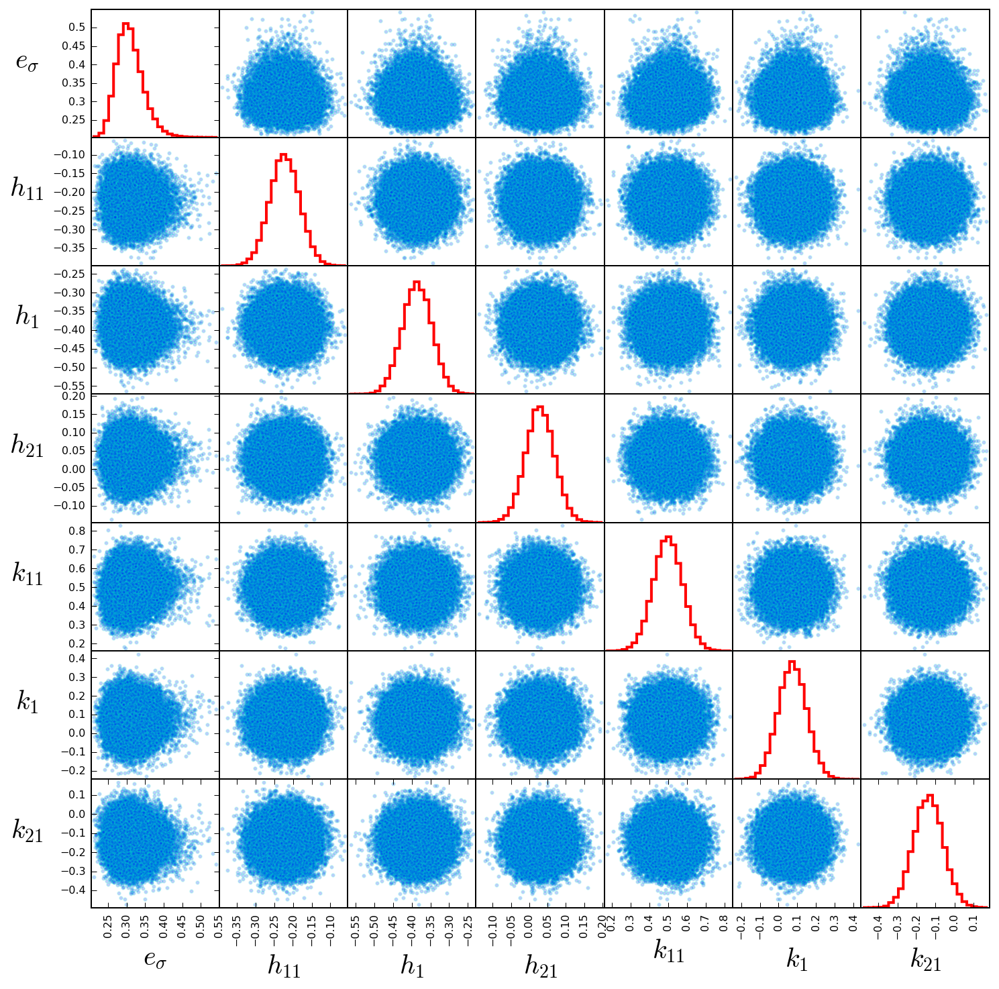

In [11]:
## Scatter matrix plot:

## Redefine the trace so that we only vizualize every 10th latent variable element in 
## the scatter_matrix plot below. Vizualizing all 50 is too cumbersome for the scatter
## matrix. 

samples_Nm1_for_scatter_matrix = {}
Nsamp=25
## adjust the thin varible to only look at every 10th population element by setting it to 10
thin = 10
numHyperParams = 1
dim = (Nsamp/thin)*2 + numHyperParams
print(dim)

for i in np.arange(0,Nsamp,thin):
    samples_Nm1_for_scatter_matrix.update({'$h_{'+str(i+1)+'}$': samples['h'][i,:,:], '$k_{'+str(i+1)+'}$': samples['k'][i,:,:]})
samples_Nm1_for_scatter_matrix.update({'$e_{\sigma}$': samples['e_sigma'].squeeze(0)})

for j, i in samples_Nm1_for_scatter_matrix.items():
    print(j)
#    print(i)

trace_2 = pd.Panel({k: v for k, v in samples_Nm1_for_scatter_matrix.items()})

sm = scatter_matrix(trace_2.to_frame(),  color="darkturquoise", alpha=0.2, figsize=(dim*2, dim*2), diagonal='hist',hist_kwds={'bins':25,'histtype':'step', 'edgecolor':'r','linewidth':2})
## y labels size
[plt.setp(item.yaxis.get_label(), 'size', 20) for item in sm.ravel()]
## x labels size 
[plt.setp(item.xaxis.get_label(), 'size', 20) for item in sm.ravel()]
## Change label rotation
## This is helpful for very long labels
#[s.xaxis.label.set_rotation(45) for s in sm.reshape(-1)]
[s.xaxis.label.set_rotation(0) for s in sm.reshape(-1)]
[s.yaxis.label.set_rotation(0) for s in sm.reshape(-1)]
## May need to offset label when rotating to prevent overlap of figure
[s.get_yaxis().set_label_coords(-0.5,0.5) for s in sm.reshape(-1)]
## Hide all ticks
#[s.set_xticks(()) for s in sm.reshape(-1)]
#[s.set_yticks(()) for s in sm.reshape(-1)]

plt.savefig('scatter_matrix_Nm1_h_and_k_JAGS.png')


<h3 align="left"> 2. Generalize to a two-component Gaussian Mixture Population Model </h3>

In [12]:
## Below we designate the population values of our two-component truncated Gaussian 
## generative model. These are the truths that we should recover if our hiararchical 
## Bayesian model is properly specified and diagnostics have indicated that the simulation 
## has "not not converged".
Ndata = 25
Nm = 2
frac = [0.7,0.3]
sigmae = [0.05,0.3]

## After generating values from the population model, we now add realistic Gaussian noise 
## to create simulated measurements. 
sigmahobs = 0.04
sigmakobs = 0.08

h = np.repeat(0.,Ndata)
k = np.repeat(0.,Ndata)
hhat = np.repeat(0.,Ndata)
khat = np.repeat(0.,Ndata)
hhat_sigma  = np.repeat(sigmahobs,Ndata)
khat_sigma  = np.repeat(sigmakobs,Ndata)

#print(khat_sigma)

for i in range(0,Ndata):
    #print('i')
    #print(i)
    
    c = np.random.choice(len(frac), 1, p=frac, replace=True)
    #print(int(c))
    h[i] = rnorm_bound(1,0,sigmae[int(c)],lower_bound=-1,upper_bound=1)
    # Euler's formula: h^2 + k^2 = 1
    lb = -np.sqrt(1-h[i]**2)
    ub = np.sqrt(1-h[i]**2)
    k[i] = rnorm_bound(1,0,sigmae[int(c)],lower_bound=lb,upper_bound=ub) 
    hhat[i] = rnorm_bound(1,h[i],sigmahobs,lower_bound=-1,upper_bound=1)
    khat[i] = rnorm_bound(1,k[i],sigmakobs,lower_bound=lb,upper_bound=ub)

    
print(h, hhat, k, khat)

[  1.90728522e-01   4.16351416e-01  -4.51553983e-02   5.61052483e-02
   2.63332074e-01   3.45277147e-02  -1.77512105e-01  -4.27587281e-02
   5.04500406e-01   6.14193203e-02   6.71405485e-02  -5.22859539e-01
  -1.07109599e-02  -5.95944018e-02   8.75761340e-05   1.01034911e-01
   3.20705629e-02  -6.23424973e-02  -3.81486190e-02  -2.65185925e-02
   4.25208642e-01  -4.48275367e-02   9.30256752e-02   8.85250264e-03
  -1.94923663e-04  -7.90552908e-01  -4.58059711e-01  -2.13661150e-02
  -7.85621709e-02   1.33864735e-02  -4.19399240e-01   1.85757101e-02
   4.53592639e-01  -1.13448907e-01  -4.73125057e-02   5.68917277e-02
  -9.31369756e-02   8.16995605e-02   1.73420906e-02  -6.34705892e-02
  -6.82137670e-01   8.49280384e-02  -4.77055277e-02  -4.11854297e-02
   4.27478367e-01  -6.10022550e-02   4.82659004e-02  -1.59836982e-01
  -3.74781480e-02  -3.10298944e-02] [  2.14625050e-01   3.27705311e-01  -5.31186294e-02   7.85126872e-02
   2.55690422e-01   2.21872003e-02  -1.33668075e-01  -5.88149759e-0

Below is new JAGS model code for a two-component truncated Gaussian Mixture model:

In [13]:
# JAGS model code

code = '''

model {
        
    #Population parameters
    for (j in 1:Nm) {
        e_sigma[j] ~ dunif(0.0, 1.0)
        e_phi[j] <- 1/(e_sigma[j]*e_sigma[j])
        a[j] <- 1;
    }

    f ~ ddirch(a[])
        
    for (n in 1:Ndata){
    
        #True planet properties
        c[n] ~ dcat(f[]) 
        h[n] ~ dnorm(0, e_phi[c[n]]) T(-1,1) #Can try multivariate truncated normal in future
        k[n] ~ dnorm(0, e_phi[c[n]]) T(-sqrt(1-h[n]*h[n]),sqrt(1-h[n]*h[n]))
            
        #Observed planet properties
        hhat[n] ~ dnorm(h[n], 1.0/(hhat_sigma[n]*hhat_sigma[n])) T(-1,1)
        khat[n] ~ dnorm(k[n], 1.0/(khat_sigma[n]*khat_sigma[n])) T(-sqrt(1-hhat[n]*hhat[n]),sqrt(1-hhat[n]*hhat[n]))
    }
        
}
'''

Below, the number of iterations has been increased by a factor of 10.  This may slow down your laptop computer even more if it hasn't already crashed.  It depends on your laptop specs.  The number if iterations may need to me increased even more to reach signs of having "not not" converged. 

In [14]:
# Load additional JAGS module
pyjags.load_module('glm')
pyjags.load_module('dic')

#data list include only variables in the model
model = pyjags.Model(code, data=dict(Nm=Nm, Ndata=Ndata, hhat=hhat, khat=khat, 
                                     hhat_sigma=hhat_sigma, khat_sigma=khat_sigma), 
                     chains=4, adapt=1000)
# threads=4, chains_per_thread=1 
# 500 warmup / burn-in iterations, not used for inference.
model.sample(500, vars=[])

## Run model for desired steps, monitoring hyperparameter variables.
## Returns a dictionary with numpy array for each monitored variable.
## Shapes of returned arrays are (... shape of variable ..., iterations, chains).
## 
iters = 100000
samples2 = model.sample(iters, vars=['e_sigma', 'h', 'k', 'c', 'f'])

# Pickle the data
#with open('ecc_1_test.pkl', 'wb') as handle:
#    pickle.dump(samples, handle)
    
# Retrieve pickled data
# with open('ecc_1_test.pkl', 'rb') as handle:
#      retrieved_results = pickle.load(handle)


adapting: iterations 4000 of 4000, elapsed 0:00:04, remaining 0:00:00
sampling: iterations 2000 of 2000, elapsed 0:00:02, remaining 0:00:00
sampling: iterations 9216 of 400000, elapsed 0:00:10, remaining 0:07:04
sampling: iterations 13828 of 400000, elapsed 0:00:16, remaining 0:07:22
sampling: iterations 18192 of 400000, elapsed 0:00:22, remaining 0:07:39
sampling: iterations 22352 of 400000, elapsed 0:00:27, remaining 0:07:39
sampling: iterations 30592 of 400000, elapsed 0:00:37, remaining 0:07:32
sampling: iterations 34672 of 400000, elapsed 0:00:45, remaining 0:07:54
sampling: iterations 38520 of 400000, elapsed 0:00:52, remaining 0:08:08
sampling: iterations 42224 of 400000, elapsed 0:00:57, remaining 0:08:05
sampling: iterations 49616 of 400000, elapsed 0:01:07, remaining 0:07:52
sampling: iterations 57044 of 400000, elapsed 0:01:16, remaining 0:07:38
sampling: iterations 64556 of 400000, elapsed 0:01:26, remaining 0:07:26
sampling: iterations 72084 of 400000, elapsed 0:01:35, rem

Sort the high and low mixture components to accomidate the exchangeability of parameters. (Future work:  reprocess the sorted variables to obtain Gelman-Rubin statistics). 

0.115304477818


([array([   8.,   16.,   65.,  160.,  230.,  268.,  169.,   72.,    9.,    3.]),
  array([   3.,   15.,   58.,  154.,  274.,  271.,  162.,   56.,    5.,    2.]),
  array([   2.,   22.,   60.,  166.,  221.,  265.,  179.,   71.,   13.,    1.]),
  array([   7.,   13.,   58.,  144.,  233.,  272.,  190.,   68.,   13.,    2.])],
 array([ 0.34798515,  0.40165619,  0.45532722,  0.50899826,  0.5626693 ,
         0.61634034,  0.67001137,  0.72368241,  0.77735345,  0.83102449,
         0.88469552]),
 <a list of 4 Lists of Patches objects>)

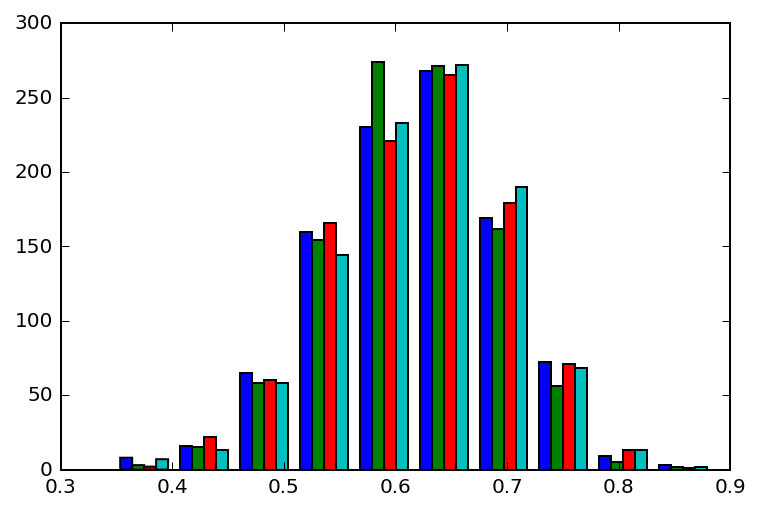

In [15]:
chain_thin = 100
start = int(iters-1000)
esigma_low = np.where(samples2['e_sigma'][0,start::,:] <= samples2['e_sigma'][1,start::,:], samples2['e_sigma'][0,start::,:], samples2['e_sigma'][1,start::,:])
esigma_hi = np.where(samples2['e_sigma'][0,start::,:] > samples2['e_sigma'][1,start::,:], samples2['e_sigma'][0,start::,:], samples2['e_sigma'][1,start::,:])
f_low = np.where(samples2['e_sigma'][0,start::,:] <= samples2['e_sigma'][1,start::,:], samples2['f'][0,start::,:], samples2['f'][1,start::,:])
f_hi = np.where(samples2['e_sigma'][0,start::,:] > samples2['e_sigma'][1,start::,:], samples2['f'][0,start::,:], samples2['f'][1,start::,:])
print(np.min(f_hi))
plt.hist(f_low)

In [18]:
iters = 100000

#print(samples)
#print(samples.items())

print(samples2['h'].shape)
print(samples2['k'][0,start::,:].shape)
print('-----')
samples_Nm2 = {}
Nsamp=25
thin = 1
numHyperParams = 4
dim = (Nsamp/thin)*2 + numHyperParams
print(dim)
for i in np.arange(0,Nsamp,thin):
    samples_Nm2.update({'$h_{'+str(i+1)+'}$': samples2['h'][i,start::,:], '$k_{'+str(i+1)+'}$': samples2['k'][i,start::,:]})
samples_Nm2.update({'$e_{\sigma_{low}}$': esigma_low, '$e_{\sigma_{high}}$': esigma_hi })
samples_Nm2.update({'$f_{low}$': f_low,'$f_{high}$': f_hi })

for j, i in samples_Nm2.items():
    print(j)
    #print(i)


(50, 100000, 4)
(1000, 4)
-----
54.0
$h_{2}$
$k_{6}$
$k_{17}$
$h_{3}$
$h_{14}$
$k_{16}$
$k_{14}$
$h_{15}$
$h_{17}$
$h_{5}$
$k_{24}$
$f_{low}$
$h_{18}$
$h_{19}$
$k_{11}$
$k_{22}$
$k_{7}$
$k_{9}$
$k_{23}$
$h_{16}$
$h_{24}$
$k_{4}$
$h_{10}$
$h_{1}$
$h_{11}$
$k_{20}$
$f_{high}$
$k_{5}$
$k_{15}$
$k_{18}$
$k_{21}$
$h_{21}$
$k_{8}$
$h_{12}$
$e_{\sigma_{low}}$
$h_{20}$
$h_{22}$
$k_{19}$
$h_{13}$
$h_{9}$
$k_{1}$
$k_{3}$
$k_{2}$
$h_{4}$
$k_{12}$
$h_{6}$
$k_{10}$
$h_{7}$
$e_{\sigma_{high}}$
$h_{25}$
$h_{8}$
$h_{23}$
$k_{25}$
$k_{13}$


In [19]:
## equal tailed 95% credible intervals, and posterior distribution means:
def summary(samples, varname, p=95):
    values = samples[varname][0]
    ci = np.percentile(values, [100-p, p])
    print('{:<6} mean = {:>5.1f}, {}% credible interval [{:>4.1f} {:>4.1f}]'.format(
      varname, np.mean(values), p, *ci))

for varname in samples_Nm2:
    summary(samples_Nm2, varname)


$h_{2}$ mean =   0.3, 95% credible interval [ 0.3  0.4]
$k_{6}$ mean =  -0.0, 95% credible interval [-0.1  0.0]
$k_{17}$ mean =   0.1, 95% credible interval [ 0.0  0.1]
$h_{3}$ mean =  -0.0, 95% credible interval [-0.0 -0.0]
$h_{14}$ mean =  -0.0, 95% credible interval [-0.1 -0.0]
$k_{16}$ mean =   0.3, 95% credible interval [ 0.3  0.4]
$k_{14}$ mean =   0.0, 95% credible interval [ 0.0  0.1]
$h_{15}$ mean =   0.0, 95% credible interval [-0.1  0.1]
$h_{17}$ mean =   0.0, 95% credible interval [-0.0  0.0]
$h_{5}$ mean =   0.3, 95% credible interval [ 0.2  0.3]
$k_{24}$ mean =   0.0, 95% credible interval [ 0.0  0.1]
$f_{low}$ mean =   0.6, 95% credible interval [ 0.5  0.6]
$h_{18}$ mean =  -0.1, 95% credible interval [-0.1 -0.0]
$h_{19}$ mean =  -0.0, 95% credible interval [-0.0  0.0]
$k_{11}$ mean =  -0.0, 95% credible interval [-0.1  0.0]
$k_{22}$ mean =   0.1, 95% credible interval [ 0.0  0.1]
$k_{7}$ mean =  -0.3, 95% credible interval [-0.4 -0.2]
$k_{9}$ mean =   0.2, 95% credible 

Variable
$e_{\sigma_{high}}$    0.394055
$e_{\sigma_{low}}$     0.034870
$f_{high}$             0.382286
$f_{low}$              0.617714
$h_{10}$               0.012632
$h_{11}$               0.040999
$h_{12}$              -0.526457
$h_{13}$              -0.011911
$h_{14}$              -0.023212
$h_{15}$              -0.008286
$h_{16}$               0.114204
$h_{17}$               0.000881
$h_{18}$              -0.036525
$h_{19}$              -0.003920
$h_{1}$                0.212685
$h_{20}$               0.009672
$h_{21}$               0.456744
$h_{22}$              -0.021009
$h_{23}$               0.041090
$h_{24}$               0.022594
$h_{25}$              -0.000515
$h_{2}$                0.323615
$h_{3}$               -0.023640
$h_{4}$                0.037087
$h_{5}$                0.252743
$h_{6}$                0.009221
$h_{7}$               -0.132533
$h_{8}$               -0.024786
$h_{9}$                0.414369
$k_{10}$              -0.002743
$k_{11}$               0.011031

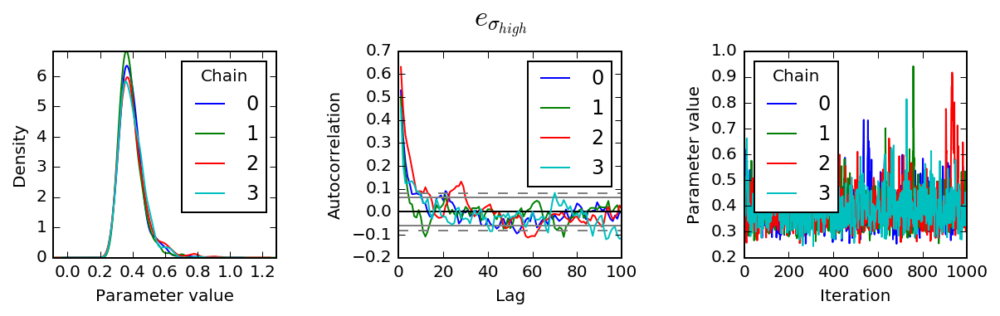

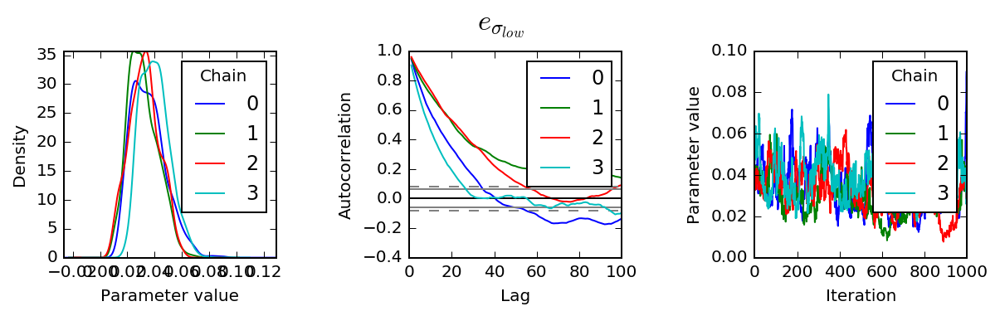

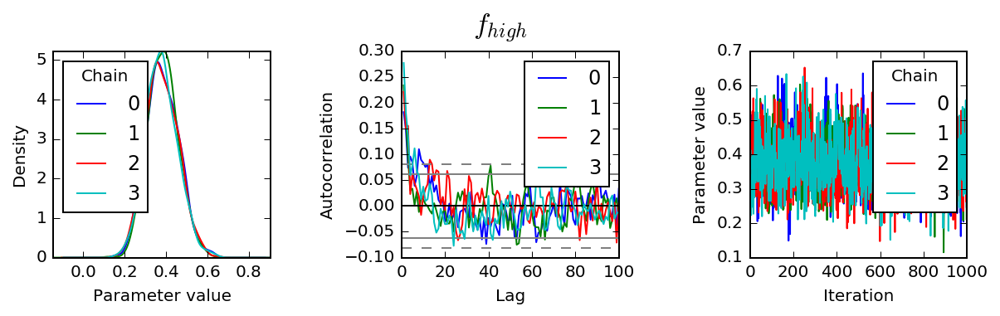

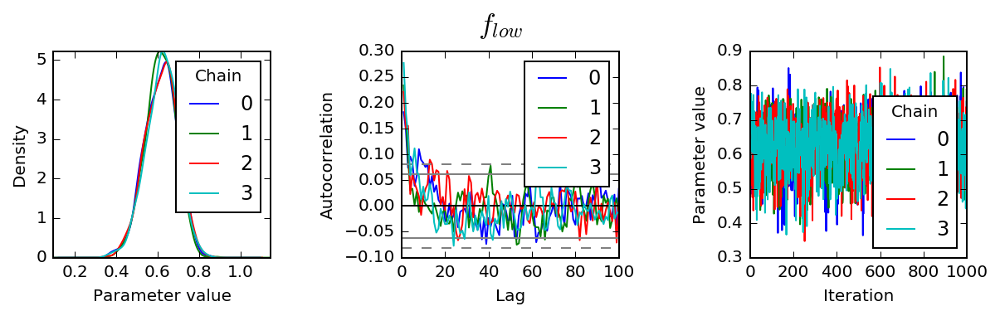

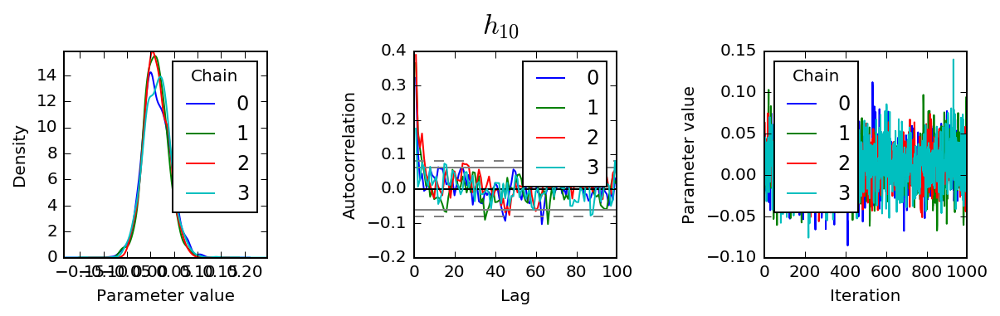

...

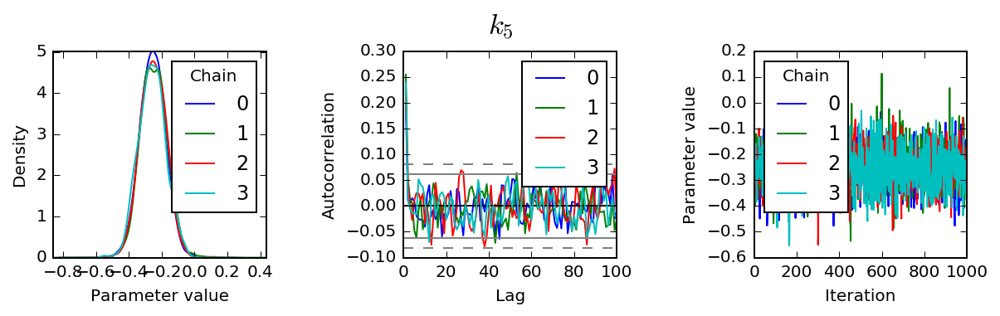

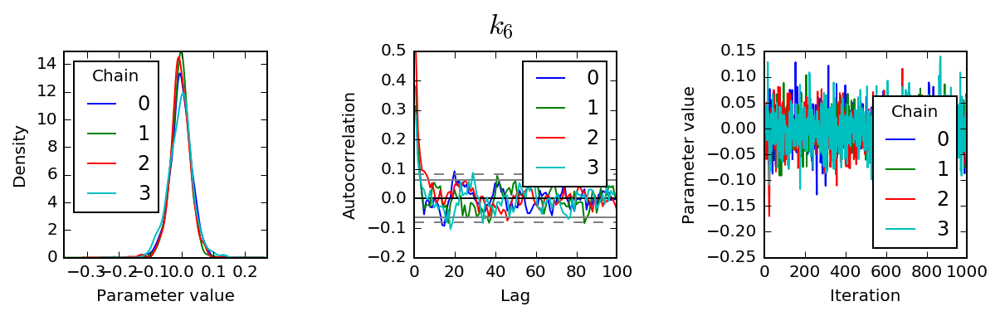

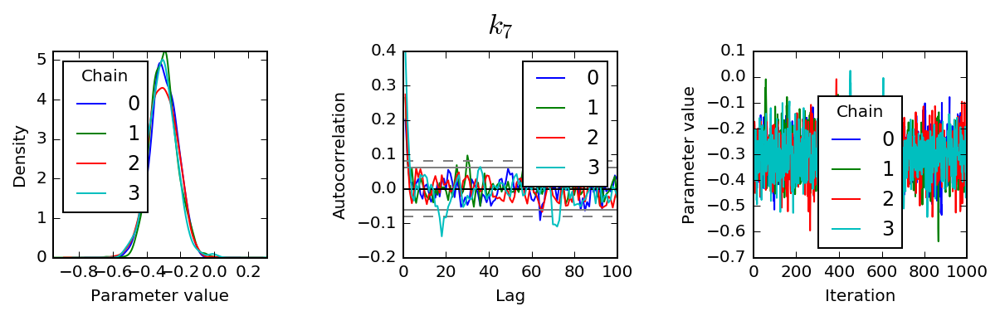

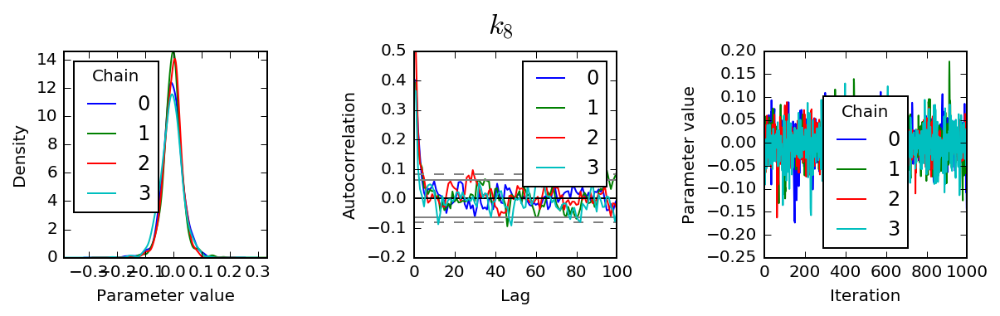

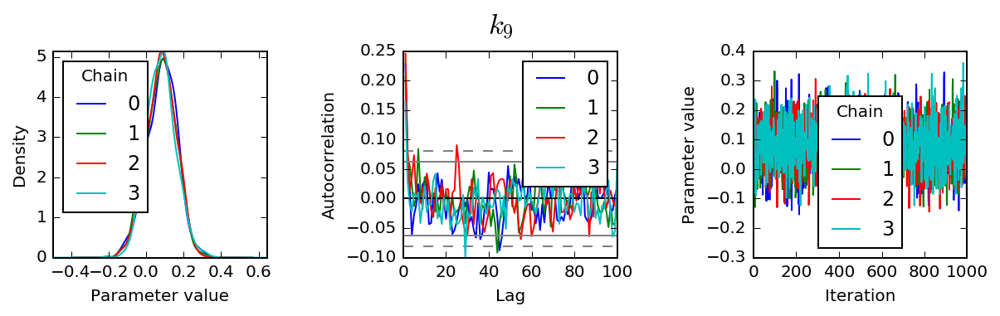

In [20]:
## Use pandas three dimensional Panel to represent the trace:

trace = pd.Panel({k: v for k, v in samples_Nm2.items()})
trace.axes[0].name = 'Variable'
trace.axes[1].name = 'Iteration'
trace.axes[2].name = 'Chain'
 
## Point estimates:
print(trace.to_frame().mean())
 
## Bayesian equal-tailed 95% credible intervals:
print(trace.to_frame().quantile([0.05, 0.95]))
  ## ^ entering the values here could be a good question part
    
def plot(trace, var):
    fig, axes = plt.subplots(1, 3, figsize=(9, 3))
    fig.suptitle(var, y=0.95, fontsize='xx-large')
 
    ## Marginal posterior density estimate:
    trace[var].plot.density(ax=axes[0])
    axes[0].set_xlabel('Parameter value')
    axes[0].locator_params(tight=True)
 
    ## Autocorrelation for each chain:
    axes[1].set_xlim(0, 100)
    for chain in trace[var].columns:
        autocorrelation_plot(trace[var,:,chain], axes[1], label=chain)
 
    ## Trace plot:
    axes[2].set_ylabel('Parameter value')
    trace[var].plot(ax=axes[2])
 
    ## Save figure
    filename = var.replace("\\", "") 
    filename = filename.replace("/", "") 
    filename = filename.replace("$", "") 
    filename = filename.replace("}", "") 
    filename = filename.replace("{", "") 
    plt.tight_layout(pad=3)
    fig.savefig('Nm2_h_and_k_JAGS_'+'{}.png'.format(filename))

    
## Display diagnostic plots
for var in trace:
    plot(trace, var)
 


14.0
$k_{21}$
$h_{21}$
$e_{\sigma_{low}}$
$h_{31}$
$h_{1}$
$h_{11}$
$f_{low}$
$h_{41}$
$f_{high}$
$k_{1}$
$k_{11}$
$k_{31}$
$k_{41}$
$e_{\sigma_{high}}$


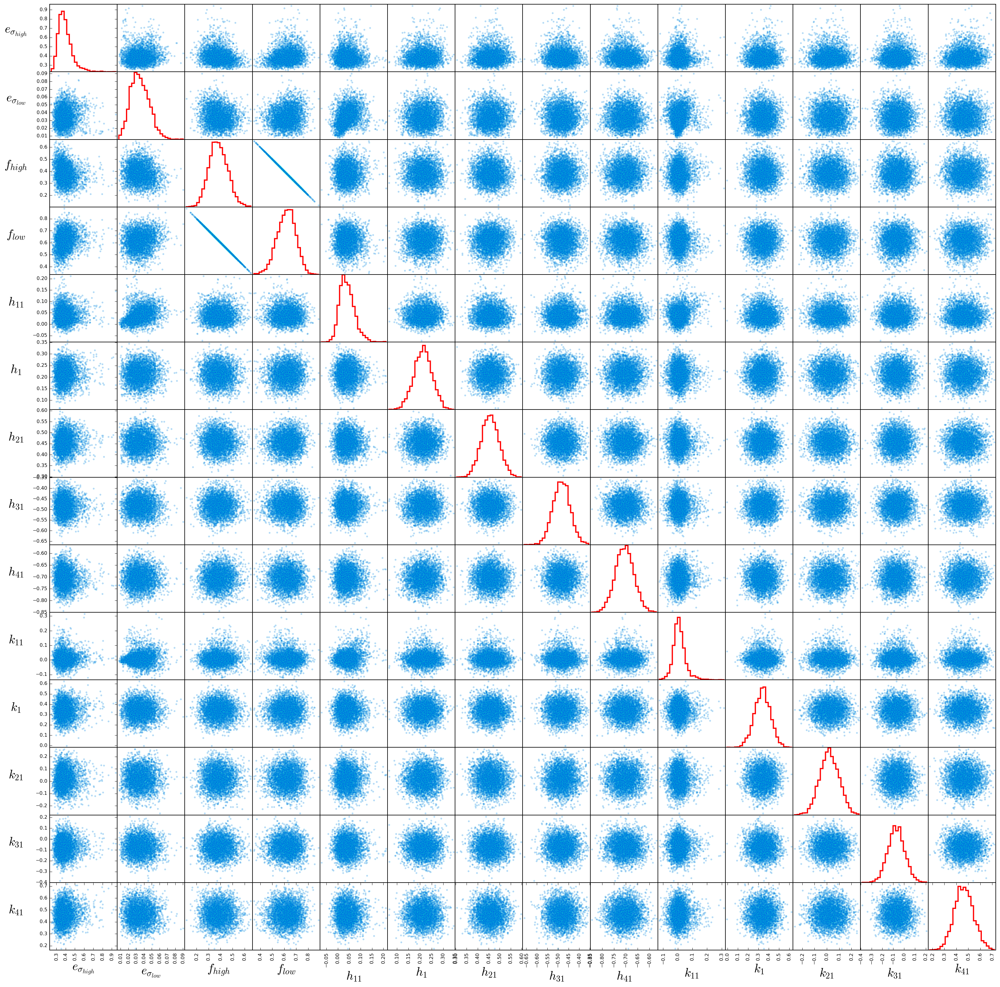

In [21]:
## Scatter matrix plot:

## Redefine the trace so that we only vizualize every 10th latent variable element in 
## the scatter_matrix plot below. Vizualizing all 50 is too cumbersome for the scatter
## matrix. 

samples_Nm2_for_scatter_matrix = {}

## adjust the thin varible to only look at every 10th population element by setting it to 10
thin = 10
numHyperParams = 4
dim = (Ndata/thin)*2 + numHyperParams
print(dim)

for i in np.arange(0,Ndata,thin):
    samples_Nm2_for_scatter_matrix.update({'$h_{'+str(i+1)+'}$': samples2['h'][i,start::,:], '$k_{'+str(i+1)+'}$': samples2['k'][i,start::,:]})
samples_Nm2_for_scatter_matrix.update({'$e_{\sigma_{low}}$': esigma_low, '$e_{\sigma_{high}}$': esigma_hi })
samples_Nm2_for_scatter_matrix.update({'$f_{low}$': f_low,'$f_{high}$': f_hi })

for j, i in samples_Nm2_for_scatter_matrix.items():
    print(j)
#    print(i)

trace_3 = pd.Panel({k: v for k, v in samples_Nm2_for_scatter_matrix.items()})

sm = scatter_matrix(trace_3.to_frame(),  color="darkturquoise", alpha=0.2, figsize=(dim*2, dim*2), diagonal='hist',hist_kwds={'bins':25,'histtype':'step', 'edgecolor':'r','linewidth':2})
## y labels size
[plt.setp(item.yaxis.get_label(), 'size', 20) for item in sm.ravel()]
## x labels size 
[plt.setp(item.xaxis.get_label(), 'size', 20) for item in sm.ravel()]
## Change label rotation
## This is helpful for very long labels
#[s.xaxis.label.set_rotation(45) for s in sm.reshape(-1)]
[s.xaxis.label.set_rotation(0) for s in sm.reshape(-1)]
[s.yaxis.label.set_rotation(0) for s in sm.reshape(-1)]
## May need to offset label when rotating to prevent overlap of figure
[s.get_yaxis().set_label_coords(-0.5,0.5) for s in sm.reshape(-1)]
## Hide all ticks
#[s.set_xticks(()) for s in sm.reshape(-1)]
#[s.set_yticks(()) for s in sm.reshape(-1)]

plt.savefig('scatter_matrix_Nm2_h_and_k_JAGS.png')
